# Imputing spatially resolved gene expression using Tangram  

Using cluster mode  

In [1]:
import squidpy as sq
import scanpy as sc
import tangram as tg
import seaborn as sns
import pandas as pd
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=80, facecolor="white")

### Load data

In [2]:
adata_sc = sc.read('../../../../spatial_pancreas_data/preprocessed_data/dissociated_nd_annotation_l0.h5ad')
adata_s1 = sc.read('../../../../../../datasets/projects/20230301_Sander_SpatialPancreas_sara.jimenez/spatial/S1_annotated_l0.h5ad')

adata_sc, adata_s1

(AnnData object with n_obs × n_vars = 21453 × 23146
     obs: 'Sample', 'doublet', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'S_score', 'G2M_score', 'phase', 'cell_type_coarse'
     var: 'n_cells'
     uns: 'Sample_colors', 'cell_type_coarse_colors', 'cell_type_coarse_sizes', 'dendrogram_cell_type_coarse', 'leiden', 'log1p', 'neighbors', 'paga', 'phase_colors'
     obsm: 'X_pca', 'X_scVI', 'X_umap'
     layers: 'counts', 'soupX_counts'
     obsp: 'connectivities', 'distances',
 AnnData object with n_obs × n_vars = 108711 × 979
     obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK

### Subsetting and pre-processing

In [3]:
cluster2annotation = {
    'Alpha' : 'Alpha',
    'Beta' : 'Beta',
    'Delta' : 'Endocrine',
    'Ductal' : 'Ductal',
    'Ductal_Acinar_MUC1_AMY2A' : 'Ductal',
    'Immune' : 'Immune',
    'T-cells' : 'Immune',
    'Fibroblasts' : 'Fibroblasts',
    'Endothelial' : 'Endothelial',
    'Lymphatic' : 'Endothelial',
    'Acinar_OLFM4+' : 'Acinar', 
    'Acinar' : 'Acinar'
}

adata_sc.obs['cell_type'] = adata_sc.obs['cell_type_coarse'].map(cluster2annotation).astype('category')

adata_sc.obs['cell_type'].cat.reorder_categories(['Acinar','Alpha','Beta','Ductal','Endocrine','Endothelial',
                                                         'Fibroblasts','Immune'])#,inplace=True)

AAACCCAGTGGTCTCG-1         Acinar
AAACCCATCCATCCGT-1         Acinar
AAACGAATCGAAATCC-1         Acinar
AAACGAATCGCCTAGG-1         Acinar
AAACGCTAGGCTAACG-1         Acinar
                         ...     
TTTGTTGGTGAGTAGC-1         Acinar
TTTGTTGGTGTATACC-1         Acinar
TTTGTTGGTGTCCACG-1         Acinar
TTTGTTGTCAACTGGT-1    Fibroblasts
TTTGTTGTCGTTAGAC-1         Acinar
Name: cell_type, Length: 21453, dtype: category
Categories (8, object): ['Acinar', 'Alpha', 'Beta', 'Ductal', 'Endocrine', 'Endothelial', 'Fibroblasts', 'Immune']

In [4]:
adata_sc.uns['cell_type_colors'] = [
    '#edd892', #acinar
    '#219ebc', #alpha
    '#adc178', #beta
    '#f79824', #ductal
    '#718355', #endocrine
    '#f15156', #endothelial
    '#bbd0ff', #Fibroblasts
    '#979dac', #Immune
]

In [5]:
adata_sp = adata_s1[np.isin(adata_s1.obs['condition'],['ND'])].copy()
adata_sp

AnnData object with n_obs × n_vars = 61460 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial', 'spatial_fov'
    layers: 'counts'

In [6]:
adata_sp.uns['cell_type_coarse_colors'] = [
    '#edd892', #acinar
    '#219ebc', #alpha
    '#adc178', #beta
    '#f79824', #ductal
    '#718355', #endocrine
    '#f15156', #endothelial
    '#bbd0ff', #Fibroblasts
    '#979dac', #Immune
    '#582f0e'  #mast
]

In [7]:
adata_sp_fov_12 = adata_sp[np.isin(adata_sp.obs['fov'],['12'])].copy()
adata_sp_fov_12

AnnData object with n_obs × n_vars = 5208 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'log1p', 'spatial', 'cell_type_coarse_colors'
    obsm: 'spatial', 'spatial_fov'
    layers: 'counts'

In [8]:
sc.pp.pca(adata_sp_fov_12)
sc.pp.neighbors(adata_sp_fov_12)
sc.tl.umap(adata_sp_fov_12)

computing PCA
    with n_comps=50
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:10)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:10)


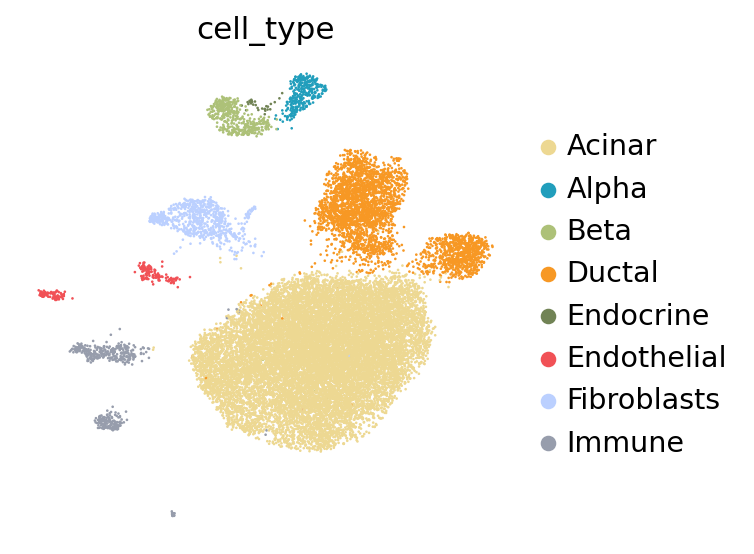

In [9]:
sc.pl.umap(adata_sc, color=['cell_type'], frameon=False,cmap='RdYlBu_r',ncols=1)

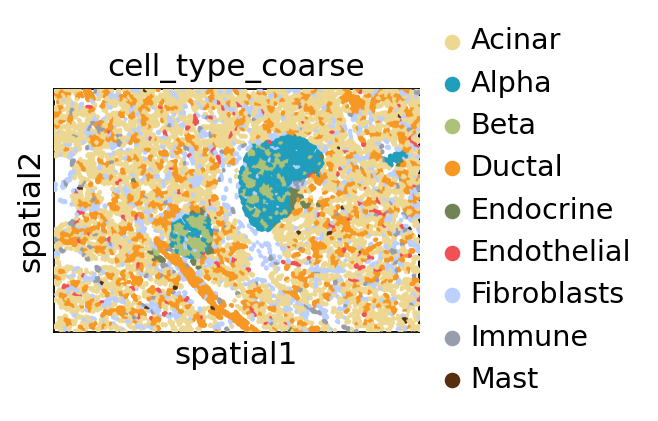

In [10]:
sq.pl.spatial_segment(adata_sp_fov_12,color=['cell_type_coarse'],
                      library_key='fov', seg_cell_id='cell_ID', img=False)

### Common gene set between reference and spatial dataset 

In [11]:
markers = list(set.intersection(set(adata_sc.var_names), set(adata_sp_fov_12.var_names)))
len(markers)

783

In [12]:
tg.pp_adatas(adata_sc, adata_sp_fov_12, genes=markers)

INFO:root:783 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:783 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [13]:
assert "training_genes" in adata_sc.uns
assert "training_genes" in adata_sp_fov_12.uns

print(f"Number of training_genes: {len(adata_sc.uns['training_genes'])}")

Number of training_genes: 783


### Computing the map from single-cells to spatial voxels

In [14]:
ad_map = tg.map_cells_to_space(
    adata_sc,
    adata_sp_fov_12,
    mode="clusters",
    cluster_label = 'cell_type',
    density_prior="rna_count_based",
    num_epochs=500,
    device="cuda:0",  # or: cpu
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 783 genes and rna_count_based density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.176, KL reg: 0.301
Score: 0.284, KL reg: 0.000
Score: 0.285, KL reg: 0.000
Score: 0.285, KL reg: 0.000
Score: 0.285, KL reg: 0.000


INFO:root:Saving results..


In [15]:
ad_map

AnnData object with n_obs × n_vars = 8 × 5208
    obs: 'cell_type', 'cluster_density'
    var: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse', 'uniform_density', 'rna_count_based_density'
    uns: 'train_genes_df', 'training_history'

### Mapping cell-types to space

In [16]:
# Project the cell annotation to spatial locations
# adds a adata_st.obsm['tangram_ct_pred']

tg.project_cell_annotations(ad_map, adata_sp_fov_12, annotation='cell_type')
annotation_list = list(pd.unique(adata_sc.obs['cell_type']))

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [17]:
adata_sp_fov_12.obsm['tangram_ct_pred'].loc['5224_12'].max()

0.00014051829930394888

In [18]:
adata_sp_fov_12.obsm['tangram_ct_pred'].idxmax(axis=1)

1_12       Endothelial
2_12            Acinar
3_12       Endothelial
4_12            Ductal
5_12            Ductal
              ...     
5224_12         Acinar
5225_12           Beta
5226_12         Immune
5227_12    Endothelial
5228_12         Acinar
Length: 5208, dtype: object

In [19]:
adata_sp_fov_12.obs['ct_tg_pred'] = adata_sp_fov_12.obsm['tangram_ct_pred'].idxmax(axis=1)

In [46]:
adata_sp_fov_12.uns['ct_tg_pred_colors'] = [
    '#edd892', #acinar
    '#219ebc', #alpha
    '#adc178', #beta
    '#f79824', #ductal
    '#718355', #endocrine
    '#f15156', #endothelial
    '#bbd0ff', #Fibroblasts
    '#979dac', #Immune
]

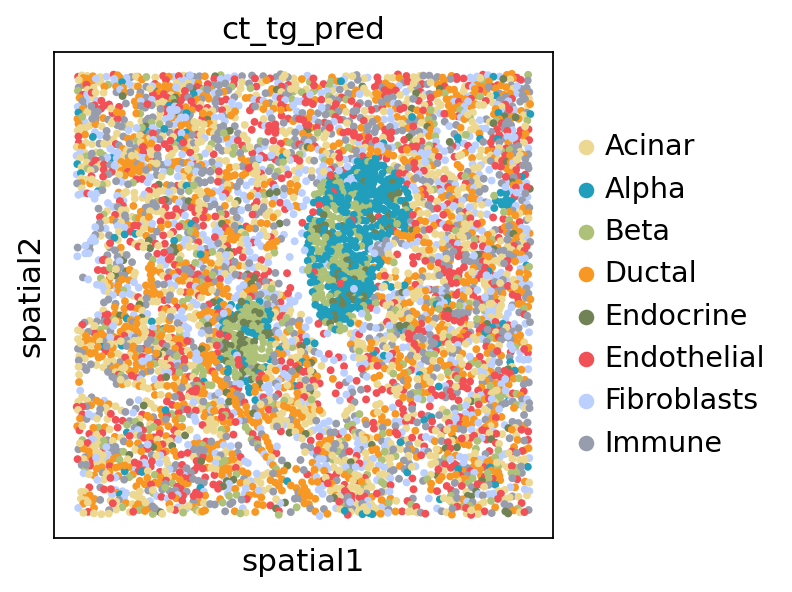

In [47]:
# not very nice 
sc.pl.embedding(
    adata_sp_fov_12,
    basis='spatial',
    color='ct_tg_pred',
    size=50,
    #alpha=0.8
)

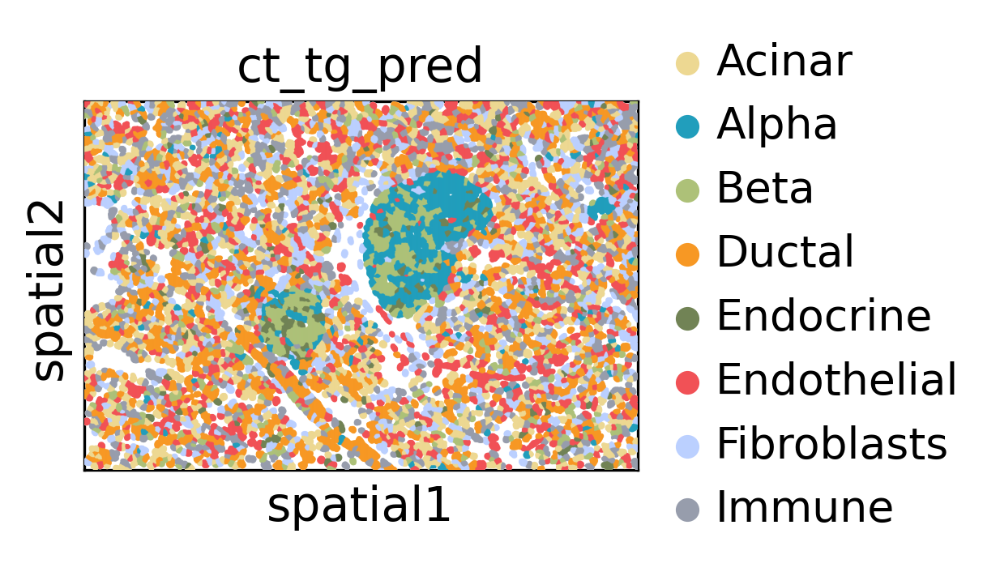

In [49]:
sc.settings.set_figure_params(dpi=150, facecolor="white")
sq.pl.spatial_segment(adata_sp_fov_12,color='ct_tg_pred',size=5,
                      library_key='fov', seg_cell_id='cell_ID',cmap='RdYlBu_r', img=False)

In [40]:
adata_sp_fov_12

AnnData object with n_obs × n_vars = 5208 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse', 'uniform_density', 'rna_count_based_density', 'ct_tg_pred', 'Acinar_tg_pred', 'Alpha_tg_pred', 'Beta_tg_pred', 'Ductal_tg_pred', 'Endocrine_tg_pred', 'Endothelial_tg_pred', 'Fibroblasts_tg_pred', 'Immune_tg_pred'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 's

In [42]:
from sklearn.metrics import f1_score

y_true = np.array(adata_sp_fov_12.obs["cell_type_coarse"])
y_pred = np.array(adata_sp_fov_12.obs["ct_tg_pred"])
                
f1 = f1_score(y_true, y_pred, average = 'weighted')
f1

0.5366533594048742

In [21]:
adata_sc.obs['cell_type'].cat.categories

Index(['Acinar', 'Alpha', 'Beta', 'Ductal', 'Endocrine', 'Endothelial',
       'Fibroblasts', 'Immune'],
      dtype='object')

In [22]:
adata_sp_fov_12.obs['Acinar_tg_pred'] = adata_sp_fov_12.obsm['tangram_ct_pred']['Acinar']
adata_sp_fov_12.obs['Alpha_tg_pred'] = adata_sp_fov_12.obsm['tangram_ct_pred']['Alpha']
adata_sp_fov_12.obs['Beta_tg_pred'] = adata_sp_fov_12.obsm['tangram_ct_pred']['Beta']
adata_sp_fov_12.obs['Ductal_tg_pred'] = adata_sp_fov_12.obsm['tangram_ct_pred']['Ductal']
adata_sp_fov_12.obs['Endocrine_tg_pred'] = adata_sp_fov_12.obsm['tangram_ct_pred']['Endocrine']
adata_sp_fov_12.obs['Endothelial_tg_pred'] = adata_sp_fov_12.obsm['tangram_ct_pred']['Endothelial']
adata_sp_fov_12.obs['Fibroblasts_tg_pred'] = adata_sp_fov_12.obsm['tangram_ct_pred']['Fibroblasts']
adata_sp_fov_12.obs['Immune_tg_pred'] = adata_sp_fov_12.obsm['tangram_ct_pred']['Immune']

In [23]:
tg_pred_ct = ['Acinar_tg_pred','Alpha_tg_pred','Beta_tg_pred','Ductal_tg_pred','Endocrine_tg_pred',
             'Endothelial_tg_pred','Fibroblasts_tg_pred','Immune_tg_pred']

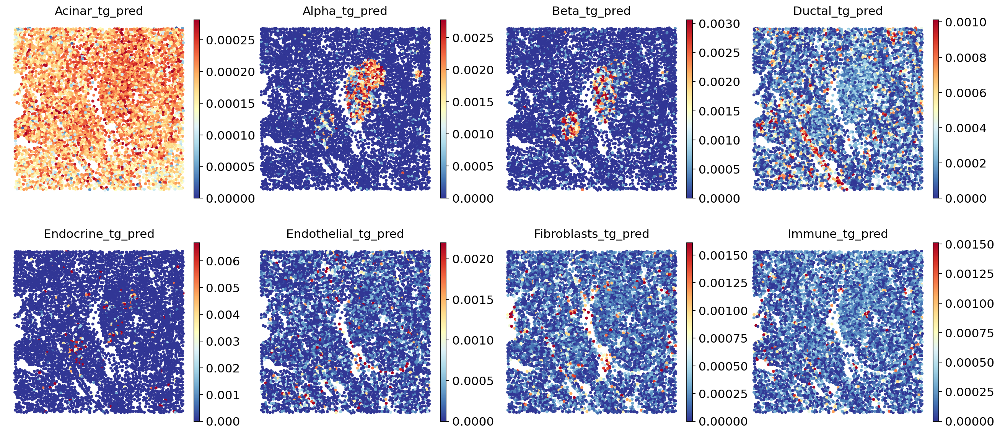

In [24]:
sc.pl.embedding(
    adata_sp_fov_12,
    basis='spatial',
    color=tg_pred_ct,
    vmin=0,
    vmax='p99',  
    sort_order=False,  
    frameon=False,
    cmap='RdYlBu_r', 
    size=50,
    #alpha=0.8
)

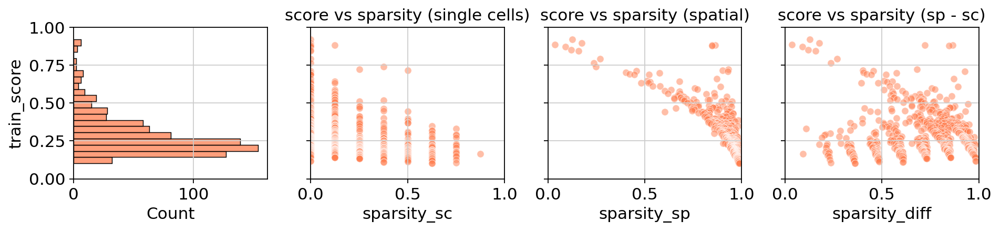

In [25]:
#  To get a deeper sense, Tangram also computes several scores, which are readily plotted
tg.plot_training_scores(ad_map, bins=20, alpha=0.5)

### Imputing genes to space

In [26]:
ad_ge = tg.project_genes(adata_map=ad_map, adata_sc=adata_sc, cluster_label='cell_type')
ad_ge

AnnData object with n_obs × n_vars = 5208 × 23146
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse', 'uniform_density', 'rna_count_based_density'
    var: 'n_cells', 'is_training'
    uns: 'Sample_colors', 'cell_type_coarse_colors', 'cell_type_coarse_sizes', 'dendrogram_cell_type_coarse', 'leiden', 'log1p', 'neighbors', 'paga', 'phase_colors', 'cell_type_colors', 'training_genes', 'overlap_genes'

In [ ]:
genes = ['ins', 'gcg']
ad_map_t1.uns['train_genes_df'].loc[genes]

In [27]:
df_all_genes = tg.compare_spatial_geneexp(ad_ge, adata_sp_fov_12, adata_sc)
df_all_genes

,score,is_training,sparsity_sp,sparsity_sc,sparsity_diff
malat1,0.919345,True,0.126920,0.000000,0.126920
mzt2a,0.895373,True,0.176075,0.948725,-0.772650
prss2,0.884333,True,0.036290,0.571668,-0.535378
chga,0.882689,True,0.864439,0.988580,-0.124140
ttr,0.880290,True,0.845814,0.981774,-0.135960
...,...,...,...,...,...
rspo2,0.111285,True,0.984639,0.999208,-0.014569
cyp19a1,0.107909,True,0.983679,0.999394,-0.015715
eomes,0.107474,True,0.987327,0.999441,-0.012113
col21a1,0.102817,True,0.986367,0.996224,-0.009857


In [28]:
ad_ge.uns['spatial'] = adata_sp_fov_12.uns['spatial']
ad_ge.obsm['spatial'] = adata_sp_fov_12.obsm['spatial']
ad_ge.obs['fov'] = adata_sp_fov_12.obs['fov']
ad_ge.obs['cell_ID'] = adata_sp_fov_12.obs['cell_ID']   

### Exploring known marker genes

In [29]:
marker_genes = {
    'Beta' : ['ins','iapp','nkx6-1','pdx1','mafa','nkx2-2','foxa1','foxa2','gck'],
    'Alpha' : ['gcg','pappa2','irx2','slc7a2','ttr','pcsk2','arx','dnmt1'],
    'Delta' : ['sst','hhex','isl1','rbp4','syt1'],
    'PP' : ['etv1','id1','id3'],
    'Ductal' : ['sox9','krt19','muc1','cdh1','ca2'],
    'Acinar' : ['cpa1','prss1','ctrb1','pnlip','amy2a','olfm4'],
    'Fibroblasts' : ['vim','col1a1','col3a1','acta2','fn1'],
    'Endothelial' : ['pecam1','vwf','cd34','eng'],
    'Lymphatic' : ['prox1','flt4'],
    'Immune' : ['cd4','cd8a','cd22','cd163','mertk','msr1','stat1','ifnar1','irf7','cd83']
}

In [30]:
marker_genes_in_data = dict()
for ct, markers in marker_genes.items():
    markers_found = list()
    for marker in markers:
        if marker in ad_ge.var.index:
            markers_found.append(marker)
    marker_genes_in_data[ct] = markers_found

In [31]:
pancreatic_ct = [
    'Beta',
    'Alpha',
    'Delta',
    'PP',
    'Ductal',
    'Acinar',
    'Fibroblasts',
    'Endothelial',
    'Lymphatic',
    'Immune'
]

BETA:


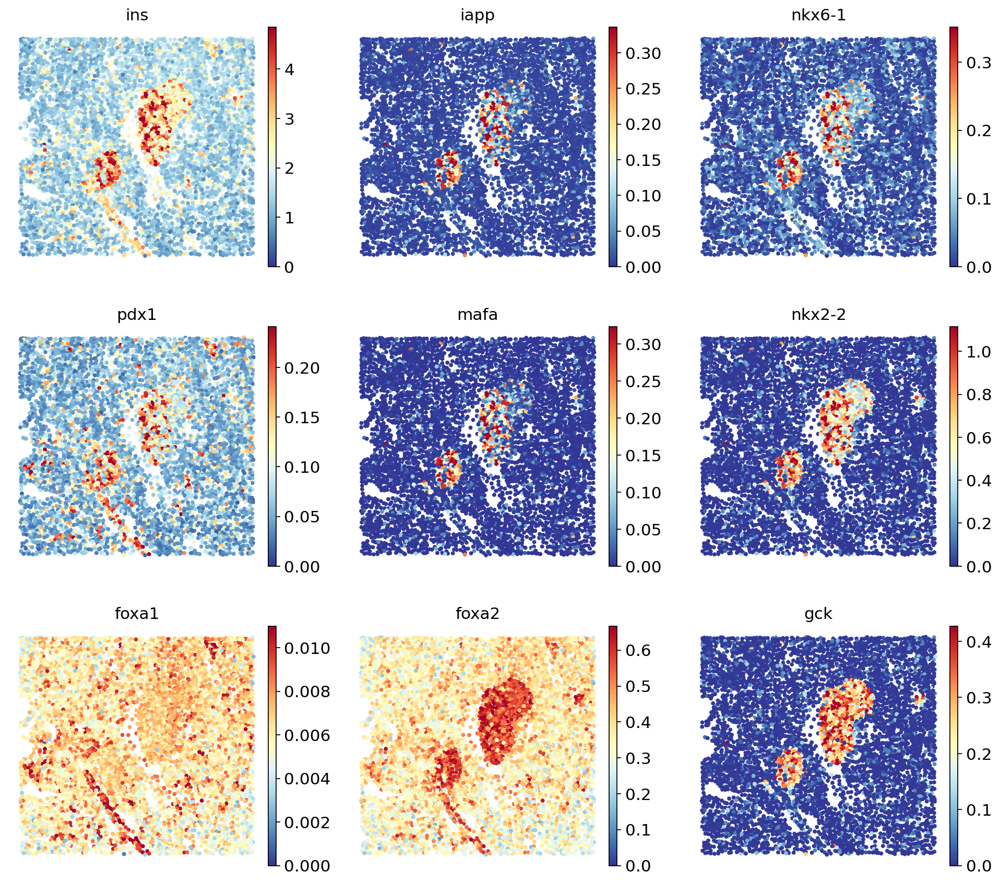





ALPHA:


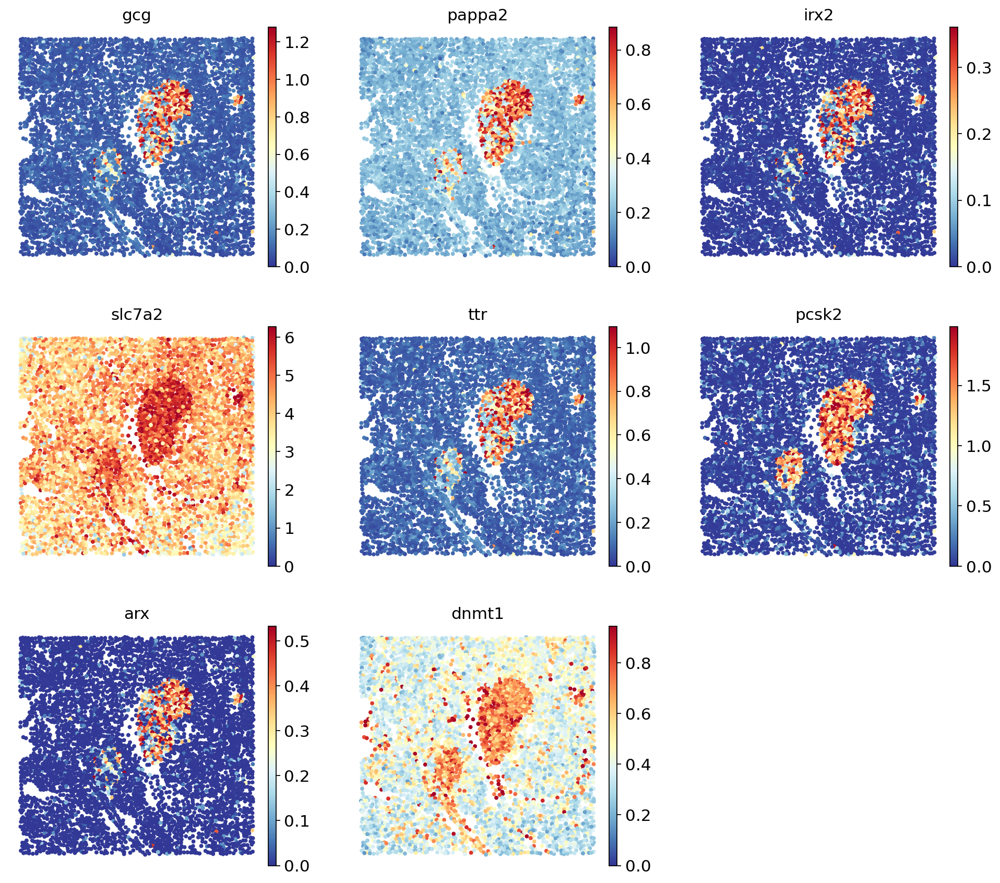





DELTA:


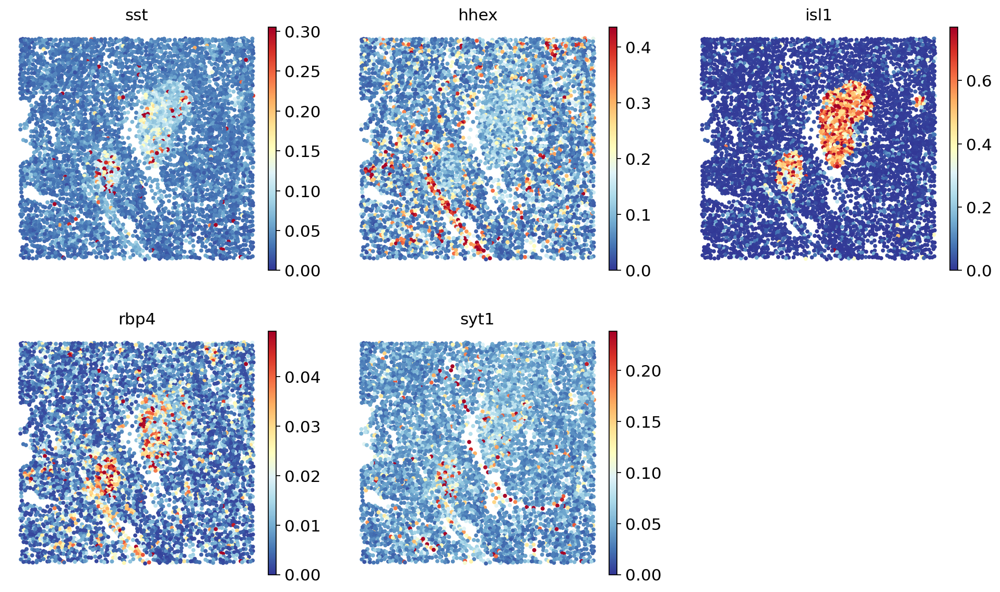





PP:


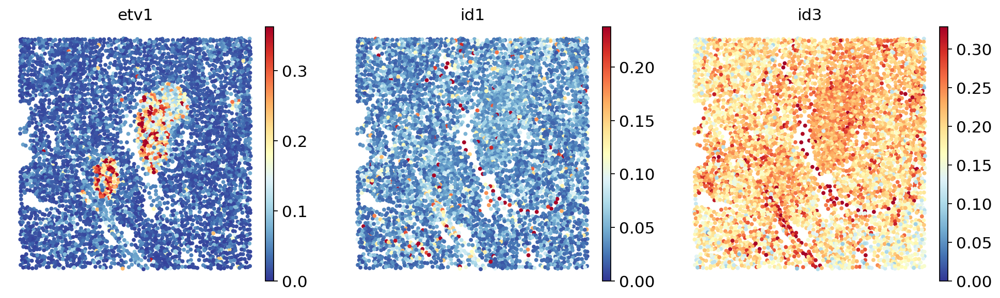





DUCTAL:


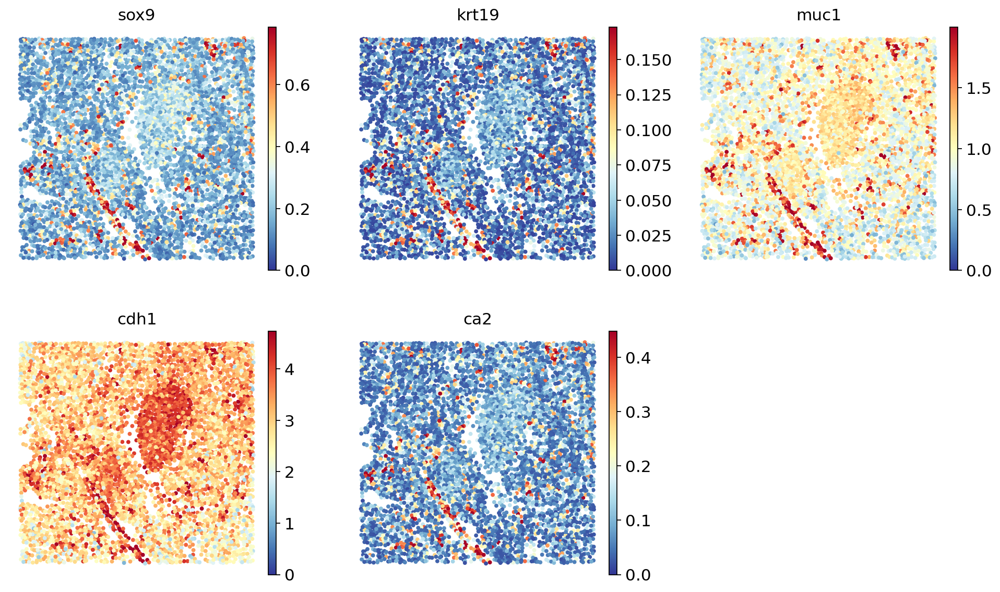





ACINAR:


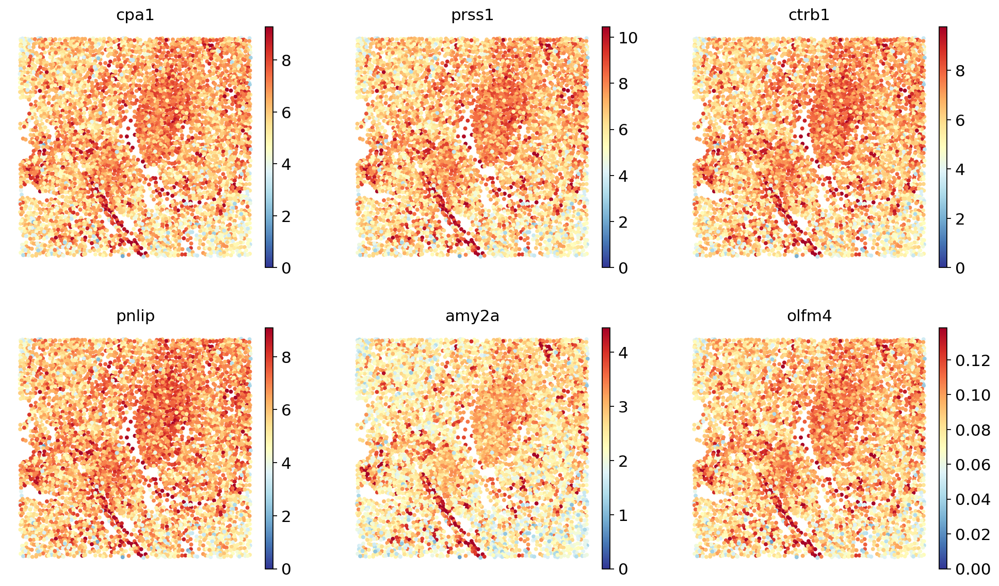





FIBROBLASTS:


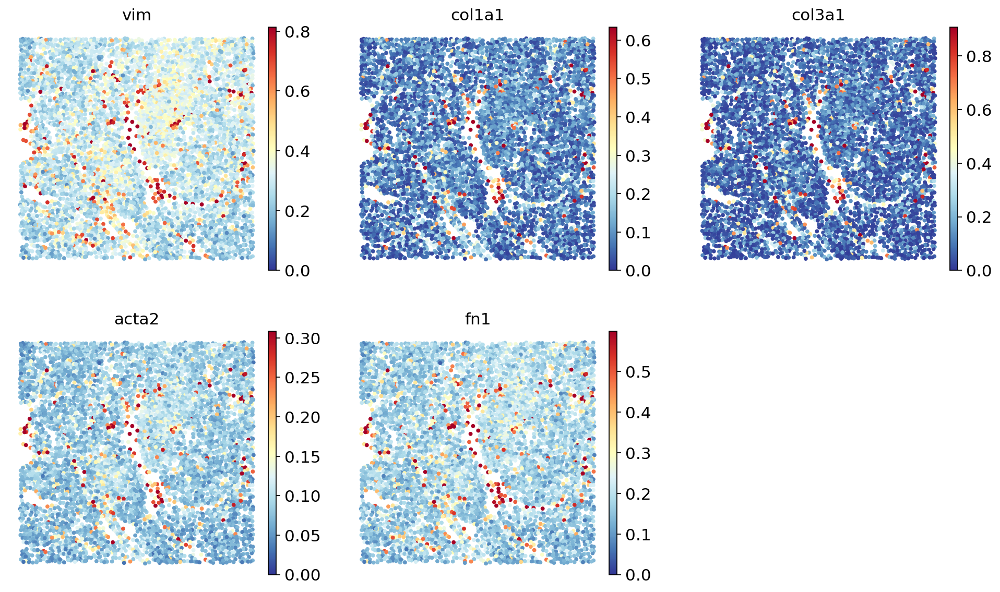





ENDOTHELIAL:


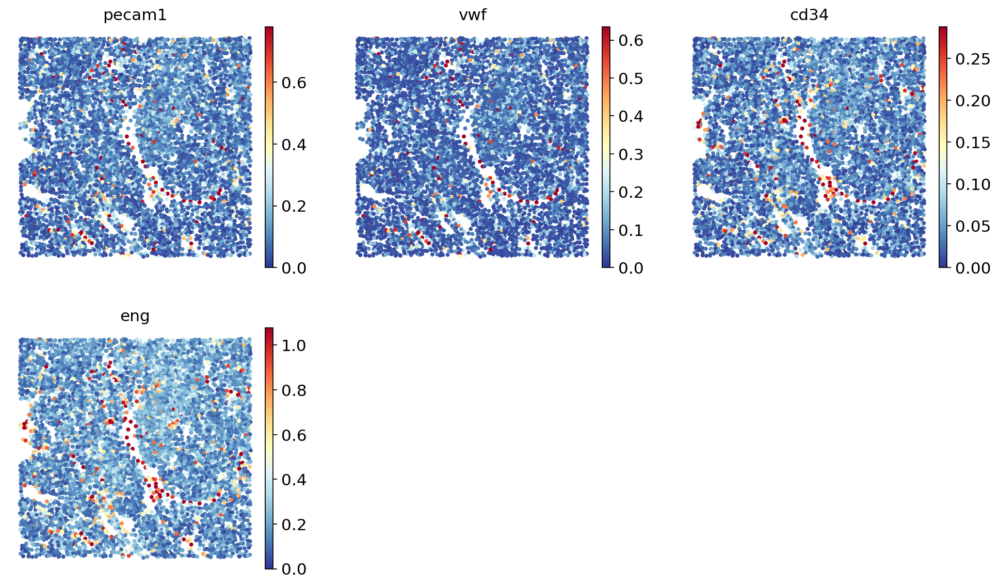





LYMPHATIC:


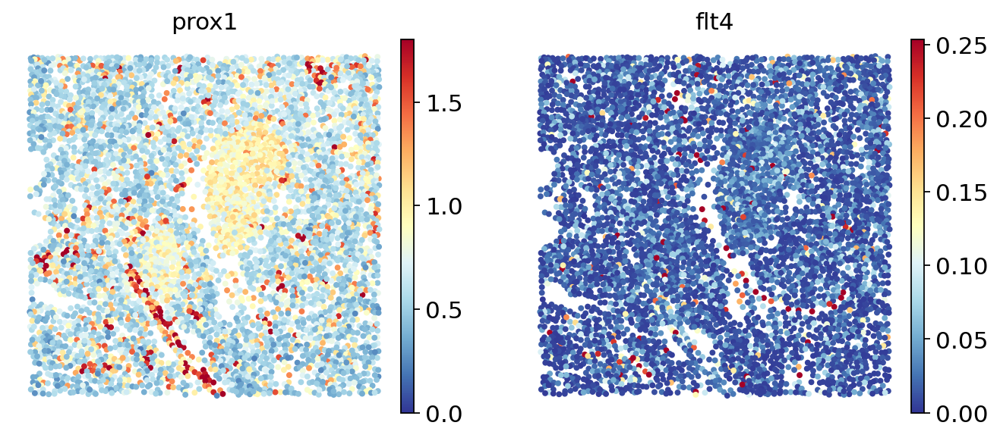





IMMUNE:


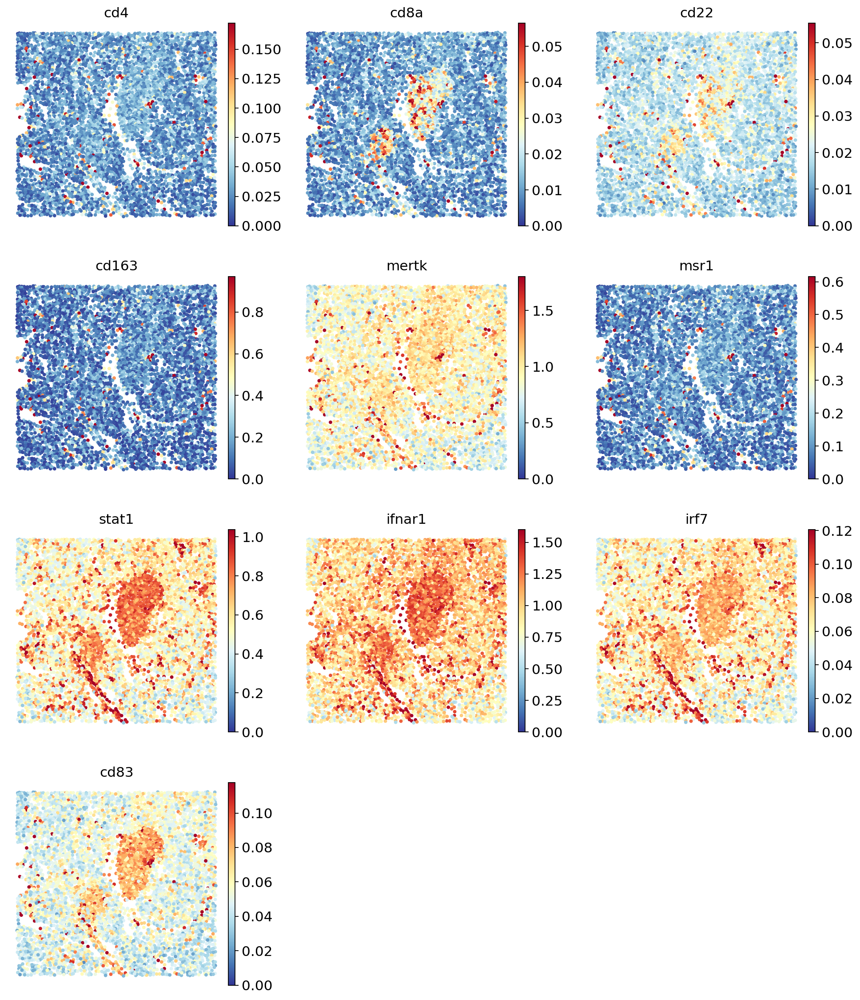

In [32]:
for ct in pancreatic_ct:
    print(f'{ct.upper()}:')  # print cell subtype name
    sc.pl.embedding(
        ad_ge,
        basis='spatial',
        color=marker_genes_in_data[ct],
        vmin=0,
        vmax='p99',  
        sort_order=False,  
        frameon=False,
        cmap='RdYlBu_r', 
        size=50,ncols=3
    )
    print('\n\n\n')  # print white space for legibility

### Validation on expression level

In [34]:
control_markers = [
    'cpb1', 'ins', 'gcg', 'spp1', 'chga', 'pecam1', 'col1a1', 'cd163'
]

In [35]:
adata_sp_fov_12

AnnData object with n_obs × n_vars = 5208 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse', 'uniform_density', 'rna_count_based_density', 'ct_tg_pred', 'Acinar_tg_pred', 'Alpha_tg_pred', 'Beta_tg_pred', 'Ductal_tg_pred', 'Endocrine_tg_pred', 'Endothelial_tg_pred', 'Fibroblasts_tg_pred', 'Immune_tg_pred'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 's

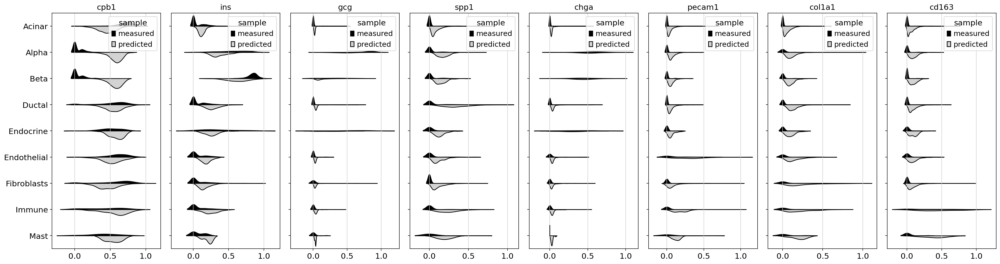

In [36]:
fig, ax = plt.subplots(1, len(control_markers), figsize=(25, 6.8), sharey=True)
for i, marker in enumerate(control_markers):
    # Retrieving measured counts
    measured = sc.get.obs_df(adata_sp_fov_12, [marker, "cell_type_coarse"])
    # Calculating measured expression levels
    measured["expression_level"] = (
        MinMaxScaler().fit(measured[[marker]]).transform(measured[[marker]])
    )

    # Retrieving measured counts
    predicted = sc.get.obs_df(ad_ge, [marker, "cell_type_coarse"])
    # Calculating predicted expression levels
    predicted["expression_level"] = (
        MinMaxScaler().fit(predicted[[marker]]).transform(predicted[[marker]])
    )

    sns.violinplot(
        data=pd.concat(
            [measured, predicted], keys=["measured", "predicted"], names=["sample"]
        ).reset_index(),
        y="cell_type_coarse",
        x="expression_level",
        hue="sample",
        split=True,
        ax=ax[i],
        inner=None,
        palette={"measured": "black", "predicted": "lightgray"}
    )
    ax[i].set_title(marker)
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")
    ax[i].get_legend()
plt.tight_layout()
plt.show()

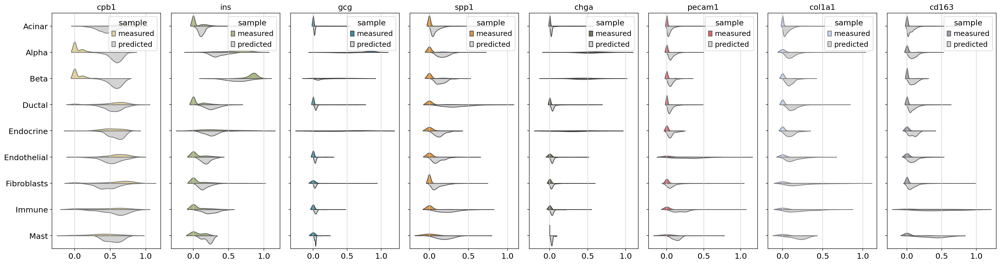

In [45]:
fig, ax = plt.subplots(1, len(control_markers), figsize=(25, 6.8), sharey=True)

color = ['#edd892', #acinar
    '#adc178', #beta
    '#219ebc', #alpha
    '#f79824', #ductal
    '#718355', #endocrine
    '#f15156', #endothelial
    '#bbd0ff', #Fibroblasts
    '#979dac'] #Immune

for i, marker in enumerate(control_markers):
    # Retrieving measured counts
    measured = sc.get.obs_df(adata_sp_fov_12, [marker, "cell_type_coarse"])
    # Calculating measured expression levels
    measured["expression_level"] = (
        MinMaxScaler().fit(measured[[marker]]).transform(measured[[marker]])
    )

    # Retrieving measured counts
    predicted = sc.get.obs_df(ad_ge, [marker, "cell_type_coarse"])
    # Calculating predicted expression levels
    predicted["expression_level"] = (
        MinMaxScaler().fit(predicted[[marker]]).transform(predicted[[marker]])
    )

    sns.violinplot(
        data=pd.concat(
            [measured, predicted], keys=["measured", "predicted"], names=["sample"]
        ).reset_index(),
        y="cell_type_coarse",
        x="expression_level",
        hue="sample",
        split=True,
        ax=ax[i],
        inner=None,
        palette={"measured": color[i], "predicted": "lightgray"}
    )
    ax[i].set_title(marker)
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")
    ax[i].get_legend()
plt.tight_layout()
plt.show()

In [37]:
from scipy.stats import pearsonr

correlations_hallmark_genes = []

for i in control_markers:
    gene = i
    obs_genes = adata_sp_fov_12[:,[gene]].X.copy().toarray().flatten()
    imp_genes = ad_ge[:,[gene]].X.copy().flatten()
    correlation, p_value = pearsonr(obs_genes, imp_genes)
    row_data = {
        'gene' : gene,
        'Pearson_correlation' : correlation,
        'P_value' : p_value
    }
    correlations_hallmark_genes.append(row_data)
                
df = pd.DataFrame(correlations_hallmark_genes)

In [43]:
df

,gene,Pearson_correlation,P_value
0,cpb1,-0.402176,9.675938e-202
1,ins,0.633478,0.000000e+00
2,gcg,0.875041,0.000000e+00
3,spp1,0.207506,9.312530e-52
4,chga,0.881707,0.000000e+00
5,pecam1,0.367670,1.965142e-166
6,col1a1,0.430910,1.600208e-234
7,cd163,0.477631,4.356965e-295


In [ ]:
df.to_csv('../corr_moscot.csv', sep='\t', index=False)

In [39]:
df['Pearson_correlation'].mean()

0.4339708982209355

In [ ]:
adata_st_fov_12.write('adata_st_fov_12_tangram.h5ad')
ad_ge.write('adata_imputed_tangram.h5ad')